### Projeto Olist - Análise de variáveis que influenciam nos Reviews de um pedido.
Em termos gerais, Olist é uma plataforma que conecta a sua loja virtual ao seu público na internet. Funciona como um facilitador de processos, uma conexão segura entre lojistas e consumidores.

Com um único contrato é possível anunciar produtos nos sites das grandes redes varejistas, com todo o suporte em gestão, logística e atendimento ao consumidor final. 

### Objetivo
Neste projeto, optei por analisar os reviews, e o que pode impactar esses reviews, causas de reviews baixos, e quais são os principais agravantes para notas baixas. Entregarei um modelo treinado com as Feature Importances explicadas, para que possamos focar em mudanças ou destacar pontos fortes.

### Base de dados
A base de dados foi retirada em: https://www.kaggle.com/olistbr/brazilian-ecommerce
Ela contém dados de pedidos, itens vendidos, fretes, vendedores, localização das entregas, e notas de review para cada pedido, no Brasil inteiro, que é a área de atuação da Olist.

- Os valores monetários estão em Reais (BRL)
- Os dados mostrados são de pedidos feitos de 09/2016 a 08/2018.

### Expectativas iniciais

- Inicio com a hipótese de que o tempo para entrega, bem como a localização dos clientes (quanto mais longe, mais tempo leva para receber seu produto) possam influenciar negativamente nos reviews
- Outra hipótese seria de que alguns tipos de produto específicos possam ter reviews em média diferentes de outros, que podem indicar que os produtos daquele tipo tem qualidade diferente, ou mesmo os consumidores daquele tipo de produto tem níveis diferentes de exigência.

### BIBLIOTECAS

In [60]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import datetime as dt
import plotly.express as px
import time
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.linear_model import Lasso
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsClassifier

### Importando e criando o DF principal

Aqui estou importando os arquivos que contém os pedidos, e agrupando com os outros arquivos que descrevem os produtos, clientes, vendedores, reviews e fretes, trazendo apenas as colunas que julguei essenciais para a análise, para melhor redimensionamento.

In [3]:
#aqui optei por retirar as colunas na linha 13 que apresentavam informações redundantes no ponto de vista do cliente,
#deixando apenas as datas que correspondem ao pedido, a entrega, e a data estimada pelo sistema no momento da compra.
#Acredito que as outras datas, para analise de review em si não façam diferença, como "data de aprovação", ou mesmo
#a coluna "order status" que apresentava que todos os pedidos foram finalizados.

base_df = pd.read_csv(r'dataset\olist_orders_dataset.csv')
base_df['order_purchase_timestamp'] = pd.to_datetime(base_df['order_purchase_timestamp'])
base_df['Purchase_date'] = [d.date() for d in base_df['order_purchase_timestamp']]

base_df['order_delivered_customer_date'] = pd.to_datetime(base_df['order_delivered_customer_date'])
base_df['Deliver_date'] = [d.date() for d in base_df['order_delivered_customer_date']]

base_df['order_estimated_delivery_date'] = pd.to_datetime(base_df['order_estimated_delivery_date'])
base_df['Estimated_deliver_date'] = [d.date() for d in base_df['order_estimated_delivery_date']]

base_df = base_df.drop(columns=['order_status', 'order_purchase_timestamp', 'order_delivered_carrier_date', 'order_approved_at', 'order_delivered_customer_date', 'order_estimated_delivery_date'])
base_df = base_df.dropna()
display(base_df)
base_df.info()


,order_id,customer_id,Purchase_date,Deliver_date,Estimated_deliver_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017-10-02,2017-10-10,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018-07-24,2018-08-07,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018-08-08,2018-08-17,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017-11-18,2017-12-02,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018-02-13,2018-02-16,2018-02-26
...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,2017-03-09,2017-03-17,2017-03-28
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,2018-02-06,2018-02-28,2018-03-02
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,2017-08-27,2017-09-21,2017-09-27
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,2018-01-08,2018-01-25,2018-02-15


<class 'pandas.core.frame.DataFrame'>
Int64Index: 96476 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   order_id                96476 non-null  object
 1   customer_id             96476 non-null  object
 2   Purchase_date           96476 non-null  object
 3   Deliver_date            96476 non-null  object
 4   Estimated_deliver_date  96476 non-null  object
dtypes: object(5)
memory usage: 4.4+ MB


In [4]:
#Juntamos aqui com os itens e seus respectivos preços

order_itens_df = pd.read_csv(r'dataset\olist_order_items_dataset.csv')
display(order_itens_df)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72


In [5]:
#decidi excluir a coluna "shipping_limit_date", pois também não impactam diretamente 
#na data de pedido e entrega do produto ao consumidor final

base_df = base_df.merge(order_itens_df, on='order_id', validate = 'many_to_many')
base_df = base_df.drop(columns=['shipping_limit_date'])

In [6]:
#Aqui juntamos a base que descreve os produtos e sua categoria, bem como dimensões do produto. Optei por retirar
#as colunas 'product_name_lenght' e 'product_description_lenght', por que descrevem o tamanho do nome do produto em si,
#não acredito ter relevância no review.

produtos_df = pd.read_csv(r'dataset\olist_products_dataset.csv')
produtos_df = produtos_df.drop(columns=['product_name_lenght', 'product_description_lenght'])
display(produtos_df)
base_df = base_df.merge(produtos_df, on='product_id')

,product_id,product_category_name,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,2.0,700.0,31.0,13.0,20.0


In [7]:
#Essa é a base de clientes compradores. Utilizaremos a localização contida na base para testar uma das hipóteses iniciais.

customers_df = pd.read_csv(r'dataset\olist_customers_dataset.csv')
display(customers_df)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS


In [8]:
base_df = base_df.merge(customers_df, on='customer_id')

In [9]:
#Antes de prosseguir para a base de reviews, uma das bases contem os prefixos de CEP com a sua latitude e longitude,
#isso nos será útil para plotar um gráfico de geolocalização, então optei por trazer para a base principal.
#Como um mesmo zipcode possui várias localizações porém muito próximas(uma casa ao lado de outra já terá valores
#diferentes para latitude e longitude), usei apenas o primeiro valor de cada prefixo de CEP para não criar valores duplicados,
#na hora de fazer o merge com a base principal.

geo_location_df = pd.read_csv(r'dataset\olist_geolocation_dataset.csv')
geo_location_df = geo_location_df.drop(columns=['geolocation_city','geolocation_state'])
geo_location_df.rename(columns={'geolocation_zip_code_prefix':'customer_zip_code_prefix','geolocation_lat':'latitude', 'geolocation_lng':'longitude'}, inplace=True)
zip_codes = geo_location_df.drop_duplicates(subset=['customer_zip_code_prefix'])
display(zip_codes)

,customer_zip_code_prefix,latitude,longitude
0,1037,-23.545621,-46.639292
1,1046,-23.546081,-46.644820
3,1041,-23.544392,-46.639499
4,1035,-23.541578,-46.641607
5,1012,-23.547762,-46.635361
...,...,...,...
999774,99955,-28.107588,-52.144019
999780,99970,-28.345143,-51.876926
999786,99910,-27.863500,-52.084760
999803,99920,-27.858716,-52.300403


In [10]:
base_df = base_df.merge(zip_codes, on='customer_zip_code_prefix')
display(base_df)

,order_id,customer_id,Purchase_date,Deliver_date,Estimated_deliver_date,order_item_id,product_id,seller_id,price,freight_value,...,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,latitude,longitude
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017-10-02,2017-10-10,2017-10-18,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,...,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,-23.574809,-46.587471
1,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,2018-03-22,2018-03-25,2018-04-04,1,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,...,1050.0,38.0,10.0,38.0,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,-23.574809,-46.587471
2,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,2018-03-22,2018-03-25,2018-04-04,2,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,...,1050.0,38.0,10.0,38.0,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,-23.574809,-46.587471
3,69923a4e07ce446644394df37a710286,31f31efcb333fcbad2b1371c8cf0fa84,2017-09-04,2017-09-05,2017-09-15,1,9abb00920aae319ef9eba674b7d2e6ff,1771297ac436903d1dd6b0e9279aa505,35.39,8.72,...,350.0,19.0,14.0,12.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,-23.574809,-46.587471
4,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,2017-08-15,2017-08-18,2017-08-28,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,...,500.0,19.0,8.0,13.0,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,-23.565578,-46.534603
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109903,fc703730f6206ec478cae91c89f7dcb3,d99700792f0811f23d94f2edb64634f8,2018-07-28,2018-08-06,2018-08-15,1,47d4f578b4130f61735dcfb66c38cb5e,0be8ff43f22e456b4e0371b2245e4d01,39.90,18.38,...,750.0,25.0,25.0,25.0,8b8c8f067a3faaf116211277147a88de,35494,desterro de entre rios,MG,-20.657355,-44.340017
109904,f1a1942c32bd91ad8368164ae571b8f7,9632f1ff07591588a9596b99f8515c03,2018-04-16,2018-04-30,2018-05-16,1,03d463c3dea9d1650ce0683b7c964b03,ea8482cd71df3c1969d7b9473ff13abc,21.99,37.04,...,350.0,17.0,4.0,12.0,1ef6a1d949703afd7a74347aed3b0503,77413,gurupi,TO,-11.743299,-49.048090
109905,ff64e0ba4800eb1127ac32aeac2b51f9,16482587049b0c2a607dd532d0653696,2017-11-20,2017-12-05,2017-12-13,1,9a3ba846b3c74a316408ccf07a40374b,26d8a1c7c75d513045798992ead43aa2,129.99,18.48,...,505.0,19.0,11.0,14.0,ebc6df639d125e446f07c0e9b1e47b90,32250,contagem,MG,-19.967817,-44.048033
109906,ada8de3a9486cea2fce7f4b00319cf3c,9065a96b91a08c08755c4ea2618884f2,2018-07-09,2018-07-24,2018-08-06,1,77b00b27cdf648f59626359c392cee1d,7142540dd4c91e2237acb7e911c4eba2,99.90,23.85,...,650.0,40.0,5.0,40.0,ed81a42bec90c87578108d2e4c742d20,44798,umburanas,BA,-10.728517,-41.324377


In [11]:
base_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 109908 entries, 0 to 109907
Data columns (total 22 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   order_id                  109908 non-null  object 
 1   customer_id               109908 non-null  object 
 2   Purchase_date             109908 non-null  object 
 3   Deliver_date              109908 non-null  object 
 4   Estimated_deliver_date    109908 non-null  object 
 5   order_item_id             109908 non-null  int64  
 6   product_id                109908 non-null  object 
 7   seller_id                 109908 non-null  object 
 8   price                     109908 non-null  float64
 9   freight_value             109908 non-null  float64
 10  product_category_name     108376 non-null  object 
 11  product_photos_qty        108376 non-null  float64
 12  product_weight_g          109890 non-null  float64
 13  product_length_cm         109890 non-null  f

In [12]:
#Aqui, decidi criar as colunas de análise das datas, para quantificar o tempo que levou entre o pedido e a entrega,
#quantos dias era a estimativa, ou seja a expectativa do cliente para receber, e a diferença entre esses prazos,
#ou seja, se o produto chegou antes do prometido, ou se atrasou.
base_df['Purchase_date'] = pd.to_datetime(base_df['Purchase_date'])
base_df['Deliver_date'] = pd.to_datetime(base_df['Deliver_date'])
base_df['Estimated_deliver_date'] = pd.to_datetime(base_df['Estimated_deliver_date'])
base_df['dias_para_entregar'] = (base_df['Deliver_date'] - base_df['Purchase_date'])
base_df['dias_prometidos_entrega'] = (base_df['Estimated_deliver_date'] - base_df['Purchase_date'])
base_df['dias_sobrando'] = base_df['dias_prometidos_entrega'] - base_df['dias_para_entregar']
base_df['dias_para_entregar'] = base_df['dias_para_entregar'].dt.days
base_df['dias_sobrando'] = base_df['dias_sobrando'].dt.days
base_df['dias_prometidos_entrega'] = base_df['dias_prometidos_entrega'].dt.days
display(base_df)
base_df.info()

,order_id,customer_id,Purchase_date,Deliver_date,Estimated_deliver_date,order_item_id,product_id,seller_id,price,freight_value,...,product_width_cm,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,latitude,longitude,dias_para_entregar,dias_prometidos_entrega,dias_sobrando
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017-10-02,2017-10-10,2017-10-18,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,...,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,-23.574809,-46.587471,8,16,8
1,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,2018-03-22,2018-03-25,2018-04-04,1,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,...,38.0,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,-23.574809,-46.587471,3,13,10
2,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,2018-03-22,2018-03-25,2018-04-04,2,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,...,38.0,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,-23.574809,-46.587471,3,13,10
3,69923a4e07ce446644394df37a710286,31f31efcb333fcbad2b1371c8cf0fa84,2017-09-04,2017-09-05,2017-09-15,1,9abb00920aae319ef9eba674b7d2e6ff,1771297ac436903d1dd6b0e9279aa505,35.39,8.72,...,12.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,-23.574809,-46.587471,1,11,10
4,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,2017-08-15,2017-08-18,2017-08-28,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,...,13.0,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,-23.565578,-46.534603,3,13,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109903,fc703730f6206ec478cae91c89f7dcb3,d99700792f0811f23d94f2edb64634f8,2018-07-28,2018-08-06,2018-08-15,1,47d4f578b4130f61735dcfb66c38cb5e,0be8ff43f22e456b4e0371b2245e4d01,39.90,18.38,...,25.0,8b8c8f067a3faaf116211277147a88de,35494,desterro de entre rios,MG,-20.657355,-44.340017,9,18,9
109904,f1a1942c32bd91ad8368164ae571b8f7,9632f1ff07591588a9596b99f8515c03,2018-04-16,2018-04-30,2018-05-16,1,03d463c3dea9d1650ce0683b7c964b03,ea8482cd71df3c1969d7b9473ff13abc,21.99,37.04,...,12.0,1ef6a1d949703afd7a74347aed3b0503,77413,gurupi,TO,-11.743299,-49.048090,14,30,16
109905,ff64e0ba4800eb1127ac32aeac2b51f9,16482587049b0c2a607dd532d0653696,2017-11-20,2017-12-05,2017-12-13,1,9a3ba846b3c74a316408ccf07a40374b,26d8a1c7c75d513045798992ead43aa2,129.99,18.48,...,14.0,ebc6df639d125e446f07c0e9b1e47b90,32250,contagem,MG,-19.967817,-44.048033,15,23,8
109906,ada8de3a9486cea2fce7f4b00319cf3c,9065a96b91a08c08755c4ea2618884f2,2018-07-09,2018-07-24,2018-08-06,1,77b00b27cdf648f59626359c392cee1d,7142540dd4c91e2237acb7e911c4eba2,99.90,23.85,...,40.0,ed81a42bec90c87578108d2e4c742d20,44798,umburanas,BA,-10.728517,-41.324377,15,28,13


<class 'pandas.core.frame.DataFrame'>
Int64Index: 109908 entries, 0 to 109907
Data columns (total 25 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   order_id                  109908 non-null  object        
 1   customer_id               109908 non-null  object        
 2   Purchase_date             109908 non-null  datetime64[ns]
 3   Deliver_date              109908 non-null  datetime64[ns]
 4   Estimated_deliver_date    109908 non-null  datetime64[ns]
 5   order_item_id             109908 non-null  int64         
 6   product_id                109908 non-null  object        
 7   seller_id                 109908 non-null  object        
 8   price                     109908 non-null  float64       
 9   freight_value             109908 non-null  float64       
 10  product_category_name     108376 non-null  object        
 11  product_photos_qty        108376 non-null  float64       
 12  pr

In [13]:
#Agora sim, juntamos a base de reviews de cada pedido e temos todos os dados que vamos analisar dentro de um unico DataFrame.

reviews_df = pd.read_csv(r'dataset\olist_order_reviews_dataset.csv')
reviews_df = reviews_df.drop(columns=['review_id', 'review_comment_title', 'review_comment_message', 'review_creation_date', 'review_answer_timestamp'])
display(reviews_df)

,order_id,review_score
0,73fc7af87114b39712e6da79b0a377eb,4
1,a548910a1c6147796b98fdf73dbeba33,5
2,f9e4b658b201a9f2ecdecbb34bed034b,5
3,658677c97b385a9be170737859d3511b,5
4,8e6bfb81e283fa7e4f11123a3fb894f1,5
...,...,...
99219,2a8c23fee101d4d5662fa670396eb8da,5
99220,22ec9f0669f784db00fa86d035cf8602,5
99221,55d4004744368f5571d1f590031933e4,5
99222,7725825d039fc1f0ceb7635e3f7d9206,4


In [14]:
base_df = base_df.merge(reviews_df, on='order_id')
display(base_df)

,order_id,customer_id,Purchase_date,Deliver_date,Estimated_deliver_date,order_item_id,product_id,seller_id,price,freight_value,...,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,latitude,longitude,dias_para_entregar,dias_prometidos_entrega,dias_sobrando,review_score
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017-10-02,2017-10-10,2017-10-18,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,...,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,-23.574809,-46.587471,8,16,8,4
1,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,2018-03-22,2018-03-25,2018-04-04,1,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,...,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,-23.574809,-46.587471,3,13,10,5
2,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,2018-03-22,2018-03-25,2018-04-04,2,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,...,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,-23.574809,-46.587471,3,13,10,5
3,69923a4e07ce446644394df37a710286,31f31efcb333fcbad2b1371c8cf0fa84,2017-09-04,2017-09-05,2017-09-15,1,9abb00920aae319ef9eba674b7d2e6ff,1771297ac436903d1dd6b0e9279aa505,35.39,8.72,...,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,-23.574809,-46.587471,1,11,10,5
4,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,2017-08-15,2017-08-18,2017-08-28,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,...,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,-23.565578,-46.534603,3,13,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109715,fc703730f6206ec478cae91c89f7dcb3,d99700792f0811f23d94f2edb64634f8,2018-07-28,2018-08-06,2018-08-15,1,47d4f578b4130f61735dcfb66c38cb5e,0be8ff43f22e456b4e0371b2245e4d01,39.90,18.38,...,8b8c8f067a3faaf116211277147a88de,35494,desterro de entre rios,MG,-20.657355,-44.340017,9,18,9,4
109716,f1a1942c32bd91ad8368164ae571b8f7,9632f1ff07591588a9596b99f8515c03,2018-04-16,2018-04-30,2018-05-16,1,03d463c3dea9d1650ce0683b7c964b03,ea8482cd71df3c1969d7b9473ff13abc,21.99,37.04,...,1ef6a1d949703afd7a74347aed3b0503,77413,gurupi,TO,-11.743299,-49.048090,14,30,16,4
109717,ff64e0ba4800eb1127ac32aeac2b51f9,16482587049b0c2a607dd532d0653696,2017-11-20,2017-12-05,2017-12-13,1,9a3ba846b3c74a316408ccf07a40374b,26d8a1c7c75d513045798992ead43aa2,129.99,18.48,...,ebc6df639d125e446f07c0e9b1e47b90,32250,contagem,MG,-19.967817,-44.048033,15,23,8,4
109718,ada8de3a9486cea2fce7f4b00319cf3c,9065a96b91a08c08755c4ea2618884f2,2018-07-09,2018-07-24,2018-08-06,1,77b00b27cdf648f59626359c392cee1d,7142540dd4c91e2237acb7e911c4eba2,99.90,23.85,...,ed81a42bec90c87578108d2e4c742d20,44798,umburanas,BA,-10.728517,-41.324377,15,28,13,5


### Removendo colunas para analisar

In [15]:
base_analise = base_df.copy()

In [16]:
#após criar uma cópia, excluí as linhas que não tinham nenhum valor para review, visto que não trazem justamente a informação analisada.
base_analise = base_analise.dropna()
base_analise.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108191 entries, 0 to 109719
Data columns (total 26 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   order_id                  108191 non-null  object        
 1   customer_id               108191 non-null  object        
 2   Purchase_date             108191 non-null  datetime64[ns]
 3   Deliver_date              108191 non-null  datetime64[ns]
 4   Estimated_deliver_date    108191 non-null  datetime64[ns]
 5   order_item_id             108191 non-null  int64         
 6   product_id                108191 non-null  object        
 7   seller_id                 108191 non-null  object        
 8   price                     108191 non-null  float64       
 9   freight_value             108191 non-null  float64       
 10  product_category_name     108191 non-null  object        
 11  product_photos_qty        108191 non-null  float64       
 12  pr

In [17]:
base_analise = base_analise.drop(columns=['customer_id', 'Deliver_date', 'Estimated_deliver_date', 'customer_unique_id', 'customer_zip_code_prefix', 'customer_city'])
display(base_analise)


,order_id,Purchase_date,order_item_id,product_id,seller_id,price,freight_value,product_category_name,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_state,latitude,longitude,dias_para_entregar,dias_prometidos_entrega,dias_sobrando,review_score
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10-02,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,utilidades_domesticas,4.0,500.0,19.0,8.0,13.0,SP,-23.574809,-46.587471,8,16,8,4
1,70b35acffdf851e782ebf6fbc35eb620,2018-03-22,1,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,cama_mesa_banho,1.0,1050.0,38.0,10.0,38.0,SP,-23.574809,-46.587471,3,13,10,5
2,70b35acffdf851e782ebf6fbc35eb620,2018-03-22,2,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,cama_mesa_banho,1.0,1050.0,38.0,10.0,38.0,SP,-23.574809,-46.587471,3,13,10,5
3,69923a4e07ce446644394df37a710286,2017-09-04,1,9abb00920aae319ef9eba674b7d2e6ff,1771297ac436903d1dd6b0e9279aa505,35.39,8.72,bebes,1.0,350.0,19.0,14.0,12.0,SP,-23.574809,-46.587471,1,11,10,5
4,128e10d95713541c87cd1a2e48201934,2017-08-15,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,utilidades_domesticas,4.0,500.0,19.0,8.0,13.0,SP,-23.565578,-46.534603,3,13,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109715,fc703730f6206ec478cae91c89f7dcb3,2018-07-28,1,47d4f578b4130f61735dcfb66c38cb5e,0be8ff43f22e456b4e0371b2245e4d01,39.90,18.38,esporte_lazer,2.0,750.0,25.0,25.0,25.0,MG,-20.657355,-44.340017,9,18,9,4
109716,f1a1942c32bd91ad8368164ae571b8f7,2018-04-16,1,03d463c3dea9d1650ce0683b7c964b03,ea8482cd71df3c1969d7b9473ff13abc,21.99,37.04,telefonia,5.0,350.0,17.0,4.0,12.0,TO,-11.743299,-49.048090,14,30,16,4
109717,ff64e0ba4800eb1127ac32aeac2b51f9,2017-11-20,1,9a3ba846b3c74a316408ccf07a40374b,26d8a1c7c75d513045798992ead43aa2,129.99,18.48,perfumaria,3.0,505.0,19.0,11.0,14.0,MG,-19.967817,-44.048033,15,23,8,4
109718,ada8de3a9486cea2fce7f4b00319cf3c,2018-07-09,1,77b00b27cdf648f59626359c392cee1d,7142540dd4c91e2237acb7e911c4eba2,99.90,23.85,automotivo,6.0,650.0,40.0,5.0,40.0,BA,-10.728517,-41.324377,15,28,13,5


In [18]:
base_analise['Purchase_date'] = base_analise['Purchase_date'].dt.strftime('%Y-%m')

In [19]:
display(base_analise)

,order_id,Purchase_date,order_item_id,product_id,seller_id,price,freight_value,product_category_name,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_state,latitude,longitude,dias_para_entregar,dias_prometidos_entrega,dias_sobrando,review_score
0,e481f51cbdc54678b7cc49136f2d6af7,2017-10,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,utilidades_domesticas,4.0,500.0,19.0,8.0,13.0,SP,-23.574809,-46.587471,8,16,8,4
1,70b35acffdf851e782ebf6fbc35eb620,2018-03,1,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,cama_mesa_banho,1.0,1050.0,38.0,10.0,38.0,SP,-23.574809,-46.587471,3,13,10,5
2,70b35acffdf851e782ebf6fbc35eb620,2018-03,2,6cc44821f36f3156c782da72dd634e47,da8622b14eb17ae2831f4ac5b9dab84a,99.90,11.79,cama_mesa_banho,1.0,1050.0,38.0,10.0,38.0,SP,-23.574809,-46.587471,3,13,10,5
3,69923a4e07ce446644394df37a710286,2017-09,1,9abb00920aae319ef9eba674b7d2e6ff,1771297ac436903d1dd6b0e9279aa505,35.39,8.72,bebes,1.0,350.0,19.0,14.0,12.0,SP,-23.574809,-46.587471,1,11,10,5
4,128e10d95713541c87cd1a2e48201934,2017-08,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,utilidades_domesticas,4.0,500.0,19.0,8.0,13.0,SP,-23.565578,-46.534603,3,13,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109715,fc703730f6206ec478cae91c89f7dcb3,2018-07,1,47d4f578b4130f61735dcfb66c38cb5e,0be8ff43f22e456b4e0371b2245e4d01,39.90,18.38,esporte_lazer,2.0,750.0,25.0,25.0,25.0,MG,-20.657355,-44.340017,9,18,9,4
109716,f1a1942c32bd91ad8368164ae571b8f7,2018-04,1,03d463c3dea9d1650ce0683b7c964b03,ea8482cd71df3c1969d7b9473ff13abc,21.99,37.04,telefonia,5.0,350.0,17.0,4.0,12.0,TO,-11.743299,-49.048090,14,30,16,4
109717,ff64e0ba4800eb1127ac32aeac2b51f9,2017-11,1,9a3ba846b3c74a316408ccf07a40374b,26d8a1c7c75d513045798992ead43aa2,129.99,18.48,perfumaria,3.0,505.0,19.0,11.0,14.0,MG,-19.967817,-44.048033,15,23,8,4
109718,ada8de3a9486cea2fce7f4b00319cf3c,2018-07,1,77b00b27cdf648f59626359c392cee1d,7142540dd4c91e2237acb7e911c4eba2,99.90,23.85,automotivo,6.0,650.0,40.0,5.0,40.0,BA,-10.728517,-41.324377,15,28,13,5


### Analise exploratória e outliers

In [20]:
#Em uma primeira analise com a função describe, podemos ver algumas colunas que possivelmente terão outliers para excluir.
#Por exemplo, a coluna de dias para entregar, em média tem 12 dias, variando do segundo para quarto quartil entre 7 e 15,
#porém há um pedido que levou 208 dias para entregar. Acredito que seja válido considerar esse dado um outlier,
#pois um prazo desses em território nacional é realmente fora do comum, pode ter havido um problema específico com essa entrega.

base_analise.describe()

,order_item_id,price,freight_value,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,latitude,longitude,dias_para_entregar,dias_prometidos_entrega,dias_sobrando,review_score
count,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000,108191.000000
mean,1.196976,119.783182,19.959354,2.208021,2092.747428,30.199092,16.573070,23.035142,-21.255754,-46.222118,12.360695,24.443512,12.082817,4.082974
std,0.694806,180.476198,15.701307,1.719890,3740.837110,16.140673,13.424816,11.693531,5.561318,4.041094,9.349983,8.840302,10.083778,1.345899
min,1.000000,0.850000,0.000000,1.000000,0.000000,7.000000,2.000000,6.000000,-36.605374,-72.666706,0.000000,3.000000,-188.000000,1.000000
25%,1.000000,39.900000,13.070000,1.000000,300.000000,18.000000,8.000000,15.000000,-23.591966,-48.123571,7.000000,19.000000,7.000000,4.000000
50%,1.000000,74.900000,16.280000,1.000000,700.000000,25.000000,13.000000,20.000000,-22.931256,-46.634905,10.000000,24.000000,13.000000,5.000000
75%,1.000000,134.000000,21.150000,3.000000,1800.000000,38.000000,20.000000,30.000000,-20.199173,-43.682545,15.000000,29.000000,17.000000,5.000000
max,21.000000,6735.000000,409.680000,20.000000,40425.000000,105.000000,105.000000,118.000000,42.184003,-8.577855,208.000000,156.000000,147.000000,5.000000


<AxesSubplot:>

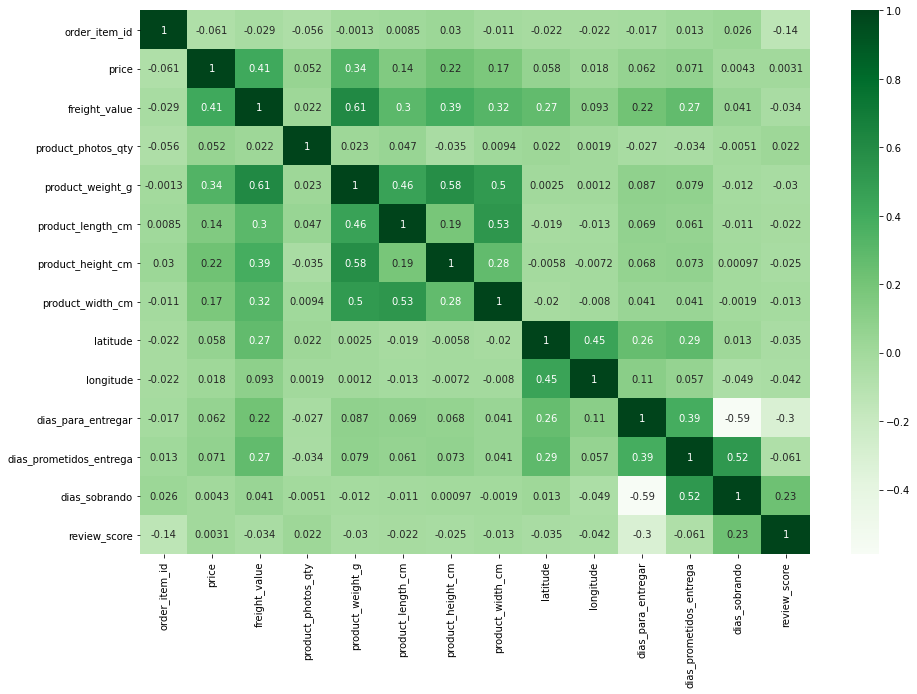

In [21]:
#Aqui uso o mapa de calor para procurar relações que tornariam colunas redundantes. Porém acredito que os dados tragam 
#correlações já esperadas e que não acredito ter necessidade de exclusão. Exemplos: valor de frete maior conforme o peso,
#dias para entregar e dias prometidos para entrega, etc. Porém, acredito que haja redundância nas colunas que descrevem
#o tamanho do produto, então irei manter apenas a coluna peso, e excluirei as colunas de tamanho dos itens.

plt.figure(figsize=(15,10))
sns.heatmap(base_analise.corr(), annot=True, cmap='Greens')

In [22]:
base_analise = base_analise.drop(columns=['product_height_cm', 'product_width_cm', 'product_length_cm'])
base_analise.info()
base_analise = base_analise.sort_values(by='Purchase_date', ascending = True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108191 entries, 0 to 109719
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   order_id                 108191 non-null  object 
 1   Purchase_date            108191 non-null  object 
 2   order_item_id            108191 non-null  int64  
 3   product_id               108191 non-null  object 
 4   seller_id                108191 non-null  object 
 5   price                    108191 non-null  float64
 6   freight_value            108191 non-null  float64
 7   product_category_name    108191 non-null  object 
 8   product_photos_qty       108191 non-null  float64
 9   product_weight_g         108191 non-null  float64
 10  customer_state           108191 non-null  object 
 11  latitude                 108191 non-null  float64
 12  longitude                108191 non-null  float64
 13  dias_para_entregar       108191 non-null  int64  
 14  dias

### Função para Outliers e Boxplot

In [23]:
def limites(coluna):
    q1 = coluna.quantile(0.25)
    q3 = coluna.quantile(0.75)
    amplitude = q3 - q1
    return q1 - 1.5 * amplitude, q3 +1.5 * amplitude

def excluir_outliers(df, nome_coluna):
    qtde_linhas = df.shape[0]
    lim_inf, lim_sup = limites(df[nome_coluna])
    df = df.loc[(df[nome_coluna] >= lim_inf) & (df[nome_coluna] <= lim_sup), :]
    return df, qtde_linhas - df.shape[0]

In [24]:
def diagrama_box(coluna):
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(15, 5)
    sns.boxplot(x=coluna, ax=ax1)
    ax2.set_xlim(limites(coluna))
    sns.boxplot(x=coluna, ax=ax2)
    
def histograma(coluna):
    plt.figure(figsize=(15, 5))
    sns.distplot(coluna)

D:\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


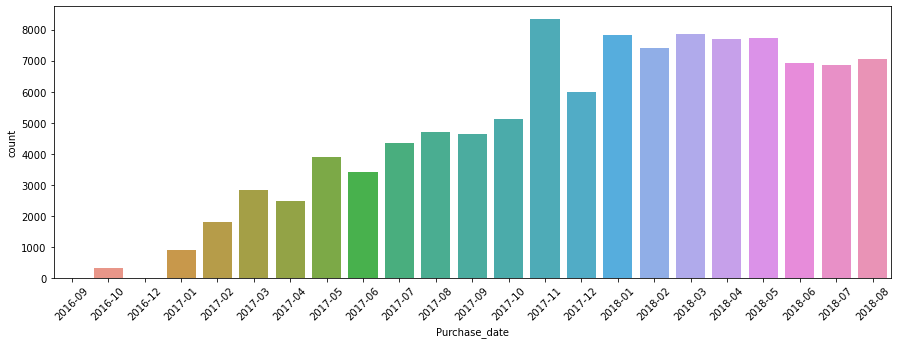

In [25]:
#Neste gráfico, apresento o volume de vendas por mês da Olist. Apesar de alguns picos (11/2017 teve o maior volume histórico)
#aparentemente as vendas crescem na média, e não demonstra nenhuma sazonalidade. Para o modelo em si, não considerarei
#a data da compra, mas sim os prazos de entrega.

plt.figure(figsize=(15,5))
grafico = sns.countplot('Purchase_date', data=base_analise)
grafico.tick_params(axis='x', rotation=45)

In [26]:
#Aqui temos o estado que estão se concentrando os volumes de venda. SP aparece como o estado com maior volume disparado.

vendas_por_estado = base_analise.groupby('customer_state').count()
vendas_por_estado = vendas_por_estado['order_id']
vendas_por_estado = vendas_por_estado.sort_values(ascending=False)
display(vendas_por_estado)

customer_state
SP    45786
RJ    13835
MG    12718
RS     6063
PR     5561
SC     4019
BA     3600
GO     2201
ES     2181
DF     2155
PE     1713
CE     1398
PA     1021
MT     1015
MS      812
MA      787
PB      570
RN      512
PI      509
AL      423
SE      370
TO      304
RO      264
AM      161
AC       89
AP       80
RR       44
Name: order_id, dtype: int64

In [27]:
#Para termos uma ideia, coloquei no mapa a distribuição de reviews pelo Brasil, e como podemos ver,
#as maiores concentrações de boas notas de review estão na região sudeste e sul, 
#o que pode ser um indicador de problemas nos fretes para locais mais distantes.

amostra = base_analise.sample(n=10000)
centro_mapa = {'lat':amostra['latitude'].mean(), 'lon':amostra['longitude'].mean()}

mapa = px.density_mapbox(amostra, lat='latitude', lon='longitude', z='review_score', radius=2.5, center = centro_mapa, zoom=2.8,
                        mapbox_style = 'carto-positron')
mapa.show()

In [28]:
#para analisar o frete, coloquei no mesmo mapa a concentração de valores, e diferentemente do que imaginava, os maiores valores
#estão na mesma região onde se encontram os maiores reviews, o que pode indicar que o valor do frete não é o problema, e sim a demora.

base_analise['Preço_total'] = base_analise['price'] + base_analise['freight_value']
amostra = base_analise.sample(n=100000)
centro_mapa = {'lat':amostra['latitude'].mean(), 'lon':amostra['longitude'].mean()}

mapa = px.density_mapbox(amostra, lat='latitude', lon='longitude', z='freight_value', radius=2.5, center = centro_mapa, zoom=3,
                        mapbox_style = 'carto-positron')
mapa.show()

In [29]:
#dado o gráfico acima, mostrei então a disposição dos valores de "dias_sobrando", que mostra que quanto maiores os valores,
#mais cedo as encomendas chegaram, e quanto menores, mais demoraram em relação ao prazo prometido na hora da compra.
#(valores negativos indicam atraso, ou seja, foi entregue em prazo superior ao prometido.)
#agora sim podemos ver que quanto mais afastado, mais próximo de 0 ou até mesmo menor que 0 se deu o prazo, talvez mostrando
#correlação com os reviews com nota baixa.

base_analise['Preço_total'] = base_analise['price'] + base_analise['freight_value']
amostra = base_analise.sample(n=50000)
centro_mapa = {'lat':amostra['latitude'].mean(), 'lon':amostra['longitude'].mean()}

mapa = px.density_mapbox(amostra, lat='latitude', lon='longitude', z='dias_sobrando', radius=2.5, center = centro_mapa, zoom=3,
                        mapbox_style = 'carto-positron')
mapa.show()

D:\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



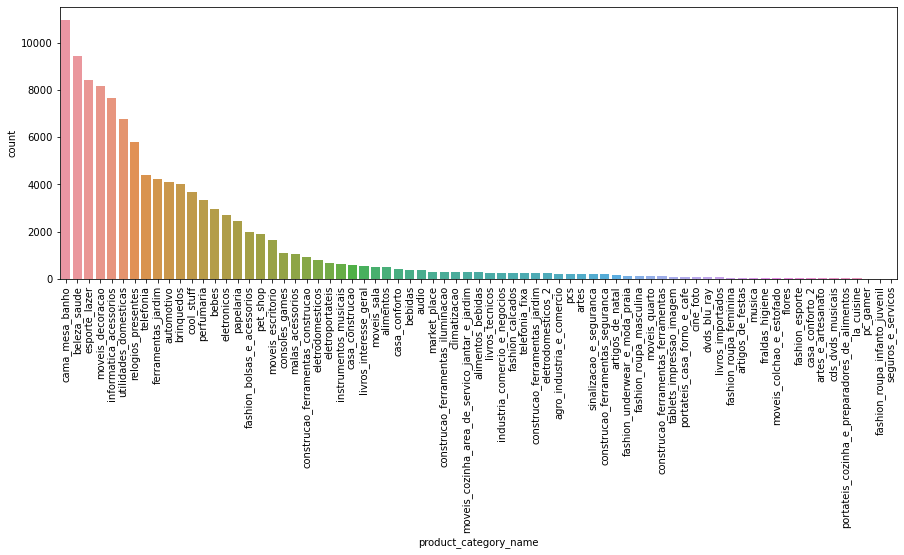

In [30]:
#para analisar o tipo de produto, fiz esse gráfico com volume por categoria, porém podemos perceber que são muitas,
#então vou utilizar a estratégia de agrupar todas as categorias que apresentarem menos de 500 itens vendidos 
#no período analisado dentro da categoria "outros"

plt.figure(figsize=(15,5))
grafico = sns.countplot('product_category_name', data=base_analise, order=base_analise['product_category_name'].value_counts().index)
grafico.tick_params(axis='x', rotation=90)

In [31]:
print(base_analise['product_category_name'].value_counts())

cama_mesa_banho                                  10958
beleza_saude                                      9431
esporte_lazer                                     8420
moveis_decoracao                                  8141
informatica_acessorios                            7646
                                                 ...  
portateis_cozinha_e_preparadores_de_alimentos       14
la_cuisine                                          13
pc_gamer                                             8
fashion_roupa_infanto_juvenil                        7
seguros_e_servicos                                   2
Name: product_category_name, Length: 73, dtype: int64


In [32]:
tabela_categoria_produtos = base_analise['product_category_name'].value_counts()

colunas_agrupar = []

for tipo in tabela_categoria_produtos.index:
    if tabela_categoria_produtos[tipo]<500:
        colunas_agrupar.append(tipo)

In [33]:
for tipo in colunas_agrupar:
    base_analise.loc[base_analise['product_category_name']==tipo , 'product_category_name'] = 'Outros'

D:\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



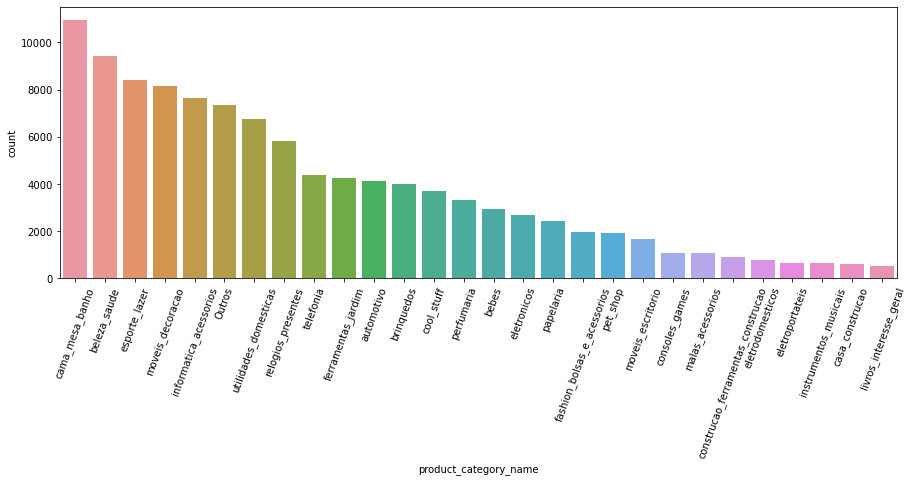

In [34]:
plt.figure(figsize=(15,5))
grafico = sns.countplot('product_category_name', data=base_analise, order=base_analise['product_category_name'].value_counts().index)
grafico.tick_params(axis='x', rotation=70)

D:\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



SP    45786
RJ    13835
MG    12718
RS     6063
PR     5561
SC     4019
BA     3600
GO     2201
ES     2181
DF     2155
PE     1713
CE     1398
PA     1021
MT     1015
MS      812
MA      787
PB      570
RN      512
PI      509
AL      423
SE      370
TO      304
RO      264
AM      161
AC       89
AP       80
RR       44
Name: customer_state, dtype: int64


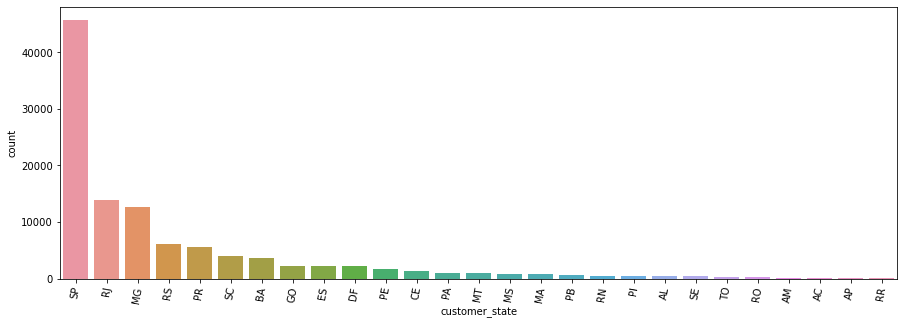

In [35]:
plt.figure(figsize=(15,5))
grafico = sns.countplot('customer_state', data=base_analise, order=base_analise['customer_state'].value_counts().index)
grafico.tick_params(axis='x', rotation=80)
print(base_analise['customer_state'].value_counts())

In [36]:
#Fiz a mesma coisa para os estados, agrupando como "outros" todos os estados com menos de 2000 produtos vendidos.

tabela_categoria_produtos = base_analise['customer_state'].value_counts()

colunas_agrupar = []

for tipo in tabela_categoria_produtos.index:
    if tabela_categoria_produtos[tipo]<2000:
        colunas_agrupar.append(tipo)
        
for tipo in colunas_agrupar:
    base_analise.loc[base_analise['customer_state']==tipo , 'customer_state'] = 'Outros'

SP        45786
RJ        13835
MG        12718
Outros    10072
RS         6063
PR         5561
SC         4019
BA         3600
GO         2201
ES         2181
DF         2155
Name: customer_state, dtype: int64


D:\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



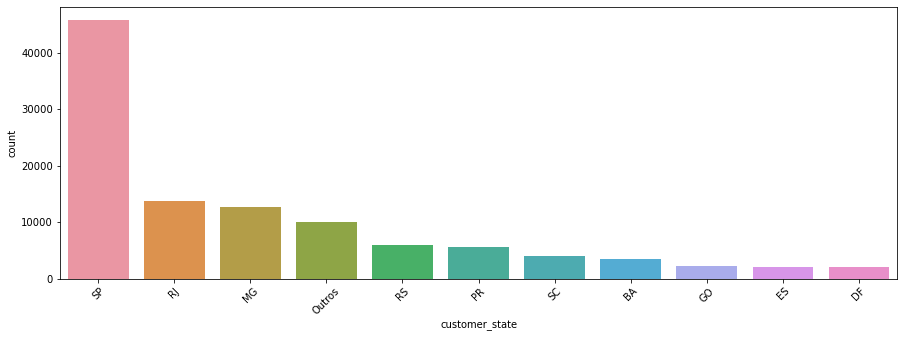

In [37]:
plt.figure(figsize=(15,5))
grafico = sns.countplot('customer_state', data=base_analise, order=base_analise['customer_state'].value_counts().index)
grafico.tick_params(axis='x', rotation=45)
print(base_analise['customer_state'].value_counts())

### Analisando outliers numéricos

 5   price                    108191 non-null  float64
 6   freight_value            108191 non-null  float64
 8   product_photos_qty       108191 non-null  float64
 9   product_weight_g         108191 non-null  float64
 14  customer_state           108191 non-null  object 
 15  latitude                 108191 non-null  float64
 16  longitude                108191 non-null  float64
 17  dias_para_entregar       108191 non-null  int64  
 18  dias_prometidos_entrega  108191 non-null  int64  
 19  dias_sobrando            108191 non-null  int64  
 20  review_score             108191 non-null  int64  

D:\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



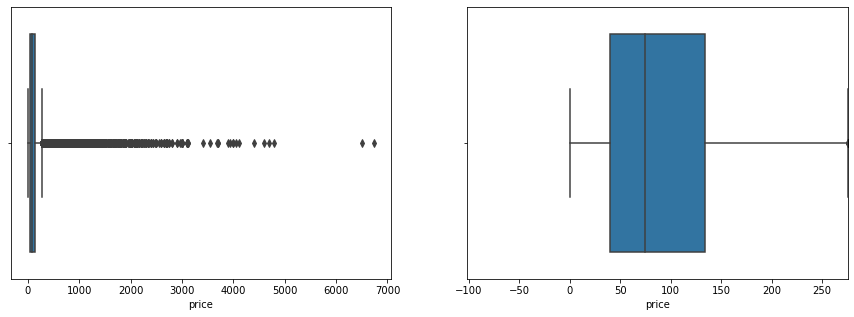

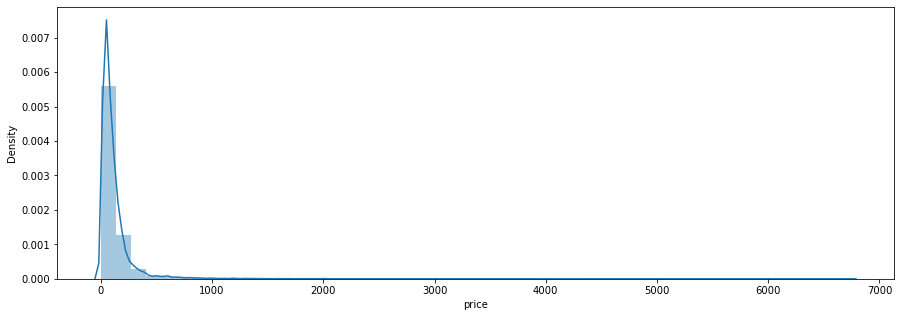

In [38]:
diagrama_box(base_analise['price'])
histograma(base_analise['price'])

In [39]:
base_analise, linhas_excluidas = excluir_outliers(base_analise, 'price')
print (linhas_excluidas)


8020


D:\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



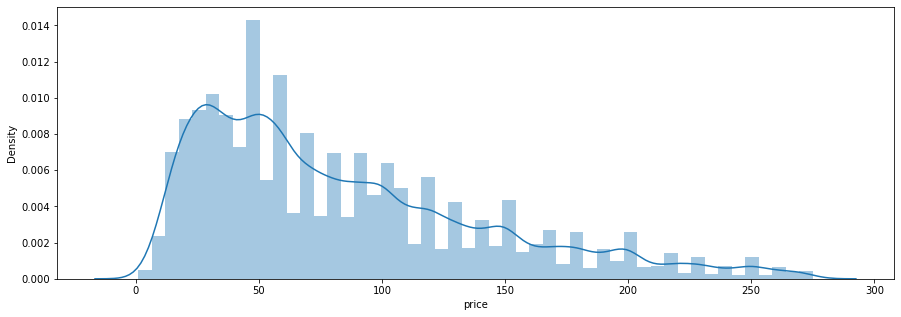

In [40]:
histograma(base_analise['price'])

D:\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



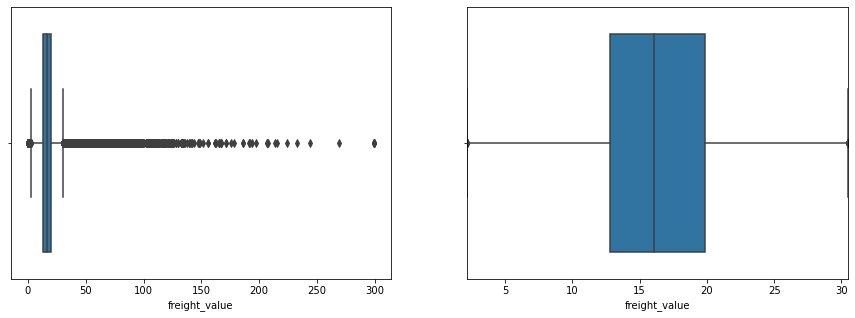

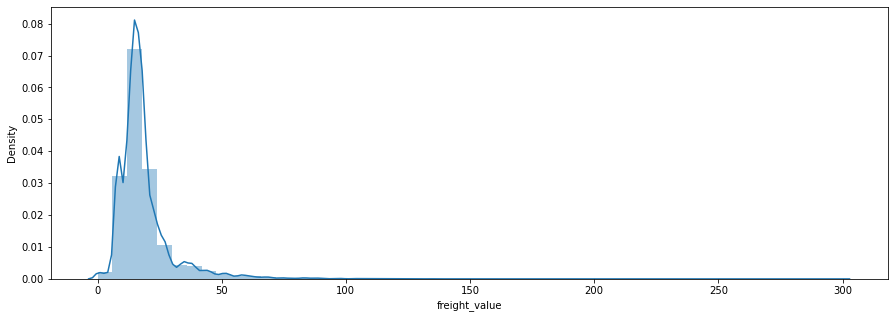

In [41]:
diagrama_box(base_analise['freight_value'])
histograma(base_analise['freight_value'])

In [42]:
base_analise, linhas_excluidas = excluir_outliers(base_analise, 'freight_value')
print (linhas_excluidas)

9825


D:\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



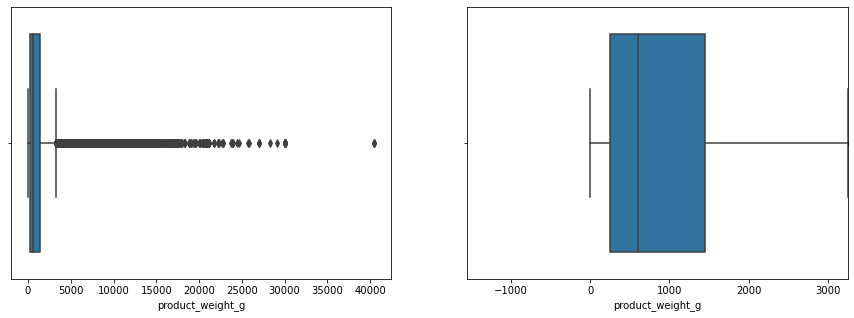

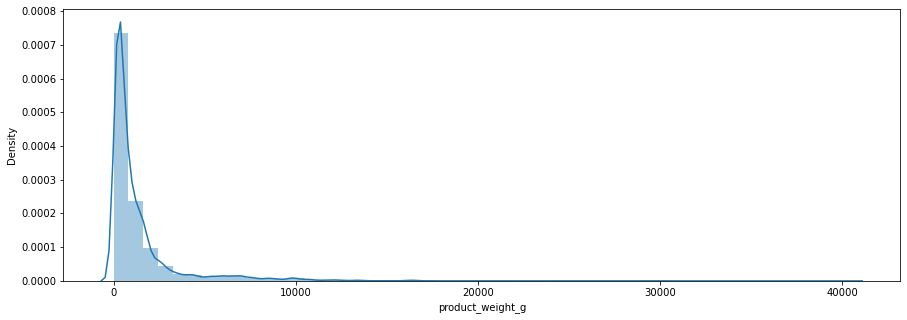

In [43]:
diagrama_box(base_analise['product_weight_g'])
histograma(base_analise['product_weight_g'])

In [44]:
base_analise, linhas_excluidas = excluir_outliers(base_analise, 'product_weight_g')
print (linhas_excluidas)

8790


D:\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



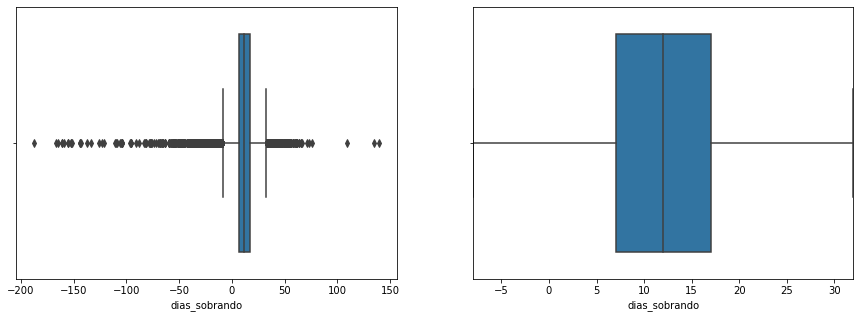

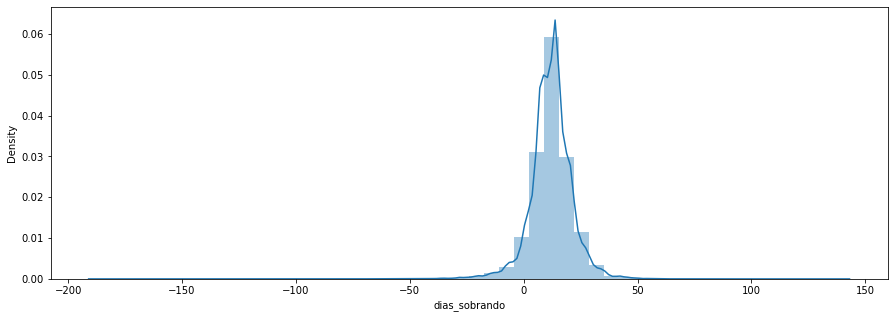

In [45]:
diagrama_box(base_analise['dias_sobrando'])
histograma(base_analise['dias_sobrando'])

In [46]:
base_analise, linhas_excluidas = excluir_outliers(base_analise, 'dias_sobrando')
print (linhas_excluidas)

3219


In [47]:
display(base_analise)

,order_id,Purchase_date,order_item_id,product_id,seller_id,price,freight_value,product_category_name,product_photos_qty,product_weight_g,customer_state,latitude,longitude,dias_para_entregar,dias_prometidos_entrega,dias_sobrando,review_score,Preço_total
28567,bb9fd560a08ca7403789dedaca85da14,2016-10,1,3c37a8a5d5ef2eca9d5e6ccf39673031,46dc3b2cc0980fb8ec44634e21d2718e,199.99,17.31,bebes,3.0,1836.0,MG,-18.915960,-48.278974,32,55,23,5,217.30
41218,3b2ca3293a7ce539ea2379d704fa37ce,2016-10,1,33e0cfd1cd80a0491da068d7a7f93ff8,dd2bdf855a9172734fbc3744021ae9b9,169.90,14.97,cama_mesa_banho,1.0,2400.0,MG,-19.839647,-43.904385,43,51,8,5,184.87
97302,8b388d845a3e8700444b971fa2bef902,2016-10,1,35bd74b6319ba18ae4f30d8b54144fd2,cca3071e3e9bb7d12640c9fbe2301306,39.90,13.40,bebes,1.0,200.0,PR,-23.185332,-52.204285,35,63,28,4,53.30
97303,8b388d845a3e8700444b971fa2bef902,2016-10,2,dc82d7e8f99966cb4c641f7ea5590eaf,cca3071e3e9bb7d12640c9fbe2301306,39.90,15.64,bebes,1.0,200.0,PR,-23.185332,-52.204285,35,63,28,4,55.54
20403,f9b03f7a6e5788ffb6cb6b4cd0d01892,2016-10,1,44377a26f7c80dbf0a9b2b300604e6bf,ecccfa2bb93b34a3bf033cc5d1dcdc69,99.90,16.27,beleza_saude,1.0,1400.0,SP,-23.141555,-47.238116,37,53,16,4,116.17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59991,4708b6cbf7e34b7dbf3f7b75d6bfbd00,2018-08,1,3d6a21fcd60617f9f10afd601e588d04,1d4587203296c8f4ad134dc286fa6db0,53.90,18.18,automotivo,2.0,1150.0,MG,-19.926177,-43.990023,7,15,8,5,72.08
59995,9e49e81744d0890cd05aeb8d8c10d28a,2018-08,1,4f00b2fac67879a28298642092faa414,6c177e38df6d3f34182b1f1d427231bf,250.00,19.90,telefonia,1.0,475.0,MG,-19.926177,-43.990023,9,13,4,5,269.90
88837,649b01370e30b79f0df619bf8ebc9201,2018-08,1,2136c70bbe723d338fab53da3c03e6dc,6560211a19b47992c3666cc44a7e94c0,29.00,7.46,relogios_presentes,3.0,200.0,SP,-23.724713,-46.705873,8,5,-3,1,36.46
59942,4569b648054760495d7fd67996def81c,2018-08,1,1cc786f2fc3932c7a07346cf556c28bf,82cb9f452fe8334df74b22d37824b431,37.80,18.37,eletroportateis,1.0,467.0,PR,-23.331044,-51.177434,6,22,16,5,56.17


In [48]:
base_encoded = base_analise.copy()

In [49]:
base_encoded = base_encoded.drop(columns=['order_id', 'order_item_id', 'product_id', 'seller_id', 'Purchase_date', 'customer_state'])


In [50]:
base_encoded = base_encoded.drop(columns=['dias_para_entregar', 'dias_prometidos_entrega'])


In [51]:
base_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 78337 entries, 28567 to 54776
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   price                  78337 non-null  float64
 1   freight_value          78337 non-null  float64
 2   product_category_name  78337 non-null  object 
 3   product_photos_qty     78337 non-null  float64
 4   product_weight_g       78337 non-null  float64
 5   latitude               78337 non-null  float64
 6   longitude              78337 non-null  float64
 7   dias_sobrando          78337 non-null  int64  
 8   review_score           78337 non-null  int64  
 9   Preço_total            78337 non-null  float64
dtypes: float64(7), int64(2), object(1)
memory usage: 6.6+ MB


In [52]:
colunas_categorias = ['product_category_name']
base_encoded = pd.get_dummies(base_encoded, columns=colunas_categorias)
base_encoded.head()

,price,freight_value,product_photos_qty,product_weight_g,latitude,longitude,dias_sobrando,review_score,Preço_total,product_category_name_Outros,...,product_category_name_livros_interesse_geral,product_category_name_malas_acessorios,product_category_name_moveis_decoracao,product_category_name_moveis_escritorio,product_category_name_papelaria,product_category_name_perfumaria,product_category_name_pet_shop,product_category_name_relogios_presentes,product_category_name_telefonia,product_category_name_utilidades_domesticas
28567,199.99,17.31,3.0,1836.0,-18.915960,-48.278974,23,5,217.30,0,...,0,0,0,0,0,0,0,0,0,0
41218,169.90,14.97,1.0,2400.0,-19.839647,-43.904385,8,5,184.87,0,...,0,0,0,0,0,0,0,0,0,0
97302,39.90,13.40,1.0,200.0,-23.185332,-52.204285,28,4,53.30,0,...,0,0,0,0,0,0,0,0,0,0
97303,39.90,15.64,1.0,200.0,-23.185332,-52.204285,28,4,55.54,0,...,0,0,0,0,0,0,0,0,0,0
20403,99.90,16.27,1.0,1400.0,-23.141555,-47.238116,16,4,116.17,0,...,0,0,0,0,0,0,0,0,0,0


In [53]:
print(base_encoded.columns)

Index(['price', 'freight_value', 'product_photos_qty', 'product_weight_g',
       'latitude', 'longitude', 'dias_sobrando', 'review_score', 'Preço_total',
       'product_category_name_Outros', 'product_category_name_automotivo',
       'product_category_name_bebes', 'product_category_name_beleza_saude',
       'product_category_name_brinquedos',
       'product_category_name_cama_mesa_banho',
       'product_category_name_casa_construcao',
       'product_category_name_consoles_games',
       'product_category_name_construcao_ferramentas_construcao',
       'product_category_name_cool_stuff',
       'product_category_name_eletrodomesticos',
       'product_category_name_eletronicos',
       'product_category_name_eletroportateis',
       'product_category_name_esporte_lazer',
       'product_category_name_fashion_bolsas_e_acessorios',
       'product_category_name_ferramentas_jardim',
       'product_category_name_informatica_acessorios',
       'product_category_name_instrumentos_mus

In [54]:
def avaliar_modelo(nome_modelo, y_test, previsao):
    r2 = r2_score(y_test, previsao)
    RSME = np.sqrt(mean_squared_error(y_test, previsao))
    return f'Modelo {nome_modelo}:\nR²:{r2}\nRSME: {RSME}'

In [55]:
modelo_rf = RandomForestRegressor()
modelo_gb = GradientBoostingRegressor()
modelo_et = ExtraTreesRegressor()
modelo_nn = MLPRegressor(alpha=1)

modelos = {'RandomForest': modelo_rf,
          'GradientBoost': modelo_gb,
          'ExtraTrees': modelo_et,
          'MLP': modelo_nn}

y=base_encoded['review_score']
x=base_encoded.drop('review_score', axis=1)



In [56]:

x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=0, train_size=0.8)

for nome_modelo, modelo in modelos.items():
    tempo_inicial = time.time()
    modelo.fit(x_train, y_train)
    previsao = modelo.predict(x_test)
    tempo_final = time.time()
    
    print("\n", avaliar_modelo(nome_modelo, y_test, previsao))
    print(f"{tempo_final - tempo_inicial} segundos")




 Modelo RandomForest:
R²:0.26343132576426465
RSME: 1.104729005924885
54.70926094055176 segundos

 Modelo GradientBoost:
R²:0.09171227966326634
RSME: 1.2267635288115457
9.836972951889038 segundos

 Modelo ExtraTrees:
R²:0.2343591344322543
RSME: 1.1263197188275649
27.170345306396484 segundos

 Modelo MLP:
R²:-0.002693647903589058
RSME: 1.2889416771496336
3.127321481704712 segundos


In [59]:
knn = KNeighborsClassifier()

tempo_inicial = time.time()
knn.fit(x_train, y_train)
previsao = knn.predict(x_test)
tempo_final = time.time()

print("\n", avaliar_modelo(knn, y_test, previsao))
print("Treino = {}\n".format(knn.score(x_train, y_train)))
print("Teste = {}\n" .format(knn.score(x_test, y_test)))


 Modelo KNeighborsClassifier():
R²:-0.49774115529638396
RSME: 1.5753153924380618
Treino = 0.6653847995021462

Teste = 0.518189941281593

